# Augmentations

**[Info]**. For larger augmentation pipeline support, please refer to use [KerasCV](https://keras.io/api/keras_cv/layers/augmentation/). It offers augmentation for classification, detection, segmentation, and many more.

---

![image](https://user-images.githubusercontent.com/17668390/169665594-608f7468-7323-41f8-9ba0-400fe9eb828f.gif)


In [1]:
import random
import numpy as np
import pandas as pd
import seaborn as sns
from glob import glob
from pylab import rcParams
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import os, gc, cv2, random, warnings, math, sys, json, pprint

# sklearn
from sklearn.utils import class_weight
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score, balanced_accuracy_score

# tf 
import tensorflow as tf
from tensorflow import keras 
from tensorflow.keras import backend as K
from tensorflow.keras.preprocessing.image import ImageDataGenerator

os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' 
warnings.simplefilter('ignore')
tf.__version__

'2.11.0'

# Data

In [2]:
IMAGE_DIM = (100, 100, 3)
BATCH_SIZ = 25
SEED  = 101

In [3]:
TRAIN_IMG_PATH = '../input/flowers-recognition/flowers'
train_datagen = ImageDataGenerator()
datagens = train_datagen.flow_from_directory(
    TRAIN_IMG_PATH,
    target_size=IMAGE_DIM[:2],
    batch_size=BATCH_SIZ,
    seed=SEED, 
    shuffle=True,
    class_mode='categorical'
)
NUM_CLASSES = 5

Found 4317 images belonging to 5 classes.


In [4]:
images, labels = next(
    iter
    (
        datagens
    )
)

images.shape, labels.shape

((25, 100, 100, 3), (25, 5))

## CutMix Augmentation

In [5]:
# keras_cv.layers.CutMix
class CutMix(keras.layers.Layer):
    """Original implementation: https://github.com/keras-team/keras-cv.
    The original implementaiton provide more interface to apply mixup on
    various CV related task, i.e. object detection etc. It also provides
    many effective validation check.
    
    Derived and modified for simpler usages: M.Innat.
    Ref. https://gist.github.com/innat/0524ee77de17f0601f0dee69aa52c713
    """

    def __init__(self, alpha=1.0, seed=None, **kwargs):
        super().__init__(**kwargs)
        self.alpha = alpha
        self.seed = seed

    @staticmethod
    def _sample_from_beta(alpha, beta, shape):
        sample_alpha = tf.random.gamma(shape, 1.0, beta=alpha)
        sample_beta = tf.random.gamma(shape, 1.0, beta=beta)
        return sample_alpha / (sample_alpha + sample_beta)

    def _cutmix_labels(self, labels, lambda_sample, permutation_order):
        cutout_labels = tf.gather(labels, permutation_order)

        lambda_sample = tf.reshape(lambda_sample, [-1, 1])
        labels = lambda_sample * labels + (1.0 - lambda_sample) * cutout_labels
        return labels

    def _cutmix_samples(self, images):
        input_shape = tf.shape(images)
        batch_size, image_height, image_width = (
            input_shape[0],
            input_shape[1],
            input_shape[2],
        )

        permutation_order = tf.random.shuffle(tf.range(0, batch_size), seed=self.seed)
        lambda_sample = CutMix._sample_from_beta(self.alpha, self.alpha, (batch_size,))

        ratio = tf.math.sqrt(1 - lambda_sample)

        cut_height = tf.cast(
            ratio * tf.cast(image_height, dtype=tf.float32), dtype=tf.int32
        )
        cut_width = tf.cast(
            ratio * tf.cast(image_height, dtype=tf.float32), dtype=tf.int32
        )

        random_center_height = tf.random.uniform(
            shape=[batch_size], minval=0, maxval=image_height, dtype=tf.int32
        )
        random_center_width = tf.random.uniform(
            shape=[batch_size], minval=0, maxval=image_width, dtype=tf.int32
        )

        bounding_box_area = cut_height * cut_width
        lambda_sample = 1.0 - bounding_box_area / (image_height * image_width)
        lambda_sample = tf.cast(lambda_sample, dtype=tf.float32)

        images = self.fill_rectangle(
            images,
            random_center_width,
            random_center_height,
            cut_width,
            cut_height,
            tf.gather(images, permutation_order),
        )

        return images, lambda_sample, permutation_order

    def call(self, batch_inputs, training=None):
        bs_images = tf.cast(batch_inputs[0], dtype=tf.float32)  
        bs_labels = tf.cast(batch_inputs[1], dtype=tf.float32)  

        cutmix_images, lambda_sample, permutation_order = self._cutmix_samples(
            bs_images
        )
        cutmix_labels = self._cutmix_labels(bs_labels, lambda_sample, permutation_order)

        return [cutmix_images, cutmix_labels]

    def fill_rectangle(
        self, images, centers_x, centers_y, widths, heights, fill_values
    ):
        images_shape = tf.shape(images)
        images_height = images_shape[1]
        images_width = images_shape[2]

        xywh = tf.stack([centers_x, centers_y, widths, heights], axis=1)
        xywh = tf.cast(xywh, tf.float32)
        corners = self.convert_format(xywh)
        mask_shape = (images_width, images_height)

        is_rectangle = self.corners_to_mask(corners, mask_shape)
        is_rectangle = tf.expand_dims(is_rectangle, -1)
        images = tf.where(is_rectangle, fill_values, images)
        return images

    def convert_format(self, boxes):
        boxes = tf.cast(boxes, dtype=tf.float32)
        x, y, width, height, rest = tf.split(boxes, [1, 1, 1, 1, -1], axis=-1)
        results = tf.concat(
            [
                x - width / 2.0,
                y - height / 2.0,
                x + width / 2.0,
                y + height / 2.0,
                rest,
            ],
            axis=-1,
        )
        return results

    def _axis_mask(self, starts, ends, mask_len):
        # index range of axis
        batch_size = tf.shape(starts)[0]
        axis_indices = tf.range(mask_len, dtype=starts.dtype)
        axis_indices = tf.expand_dims(axis_indices, 0)
        axis_indices = tf.tile(axis_indices, [batch_size, 1])

        # mask of index bounds
        axis_mask = tf.greater_equal(axis_indices, starts) & tf.less(axis_indices, ends)
        return axis_mask

    def corners_to_mask(self, bounding_boxes, mask_shape):
        mask_width, mask_height = mask_shape
        x0, y0, x1, y1 = tf.split(bounding_boxes, [1, 1, 1, 1], axis=-1)

        w_mask = self._axis_mask(x0, x1, mask_width)
        h_mask = self._axis_mask(y0, y1, mask_height)

        w_mask = tf.expand_dims(w_mask, axis=1)
        h_mask = tf.expand_dims(h_mask, axis=2)
        masks = tf.logical_and(w_mask, h_mask)
        return masks

In [6]:
with tf.device('/device:GPU:0'):
    cutmix_image, cutmix_label = CutMix()(
        [images, labels]
    )

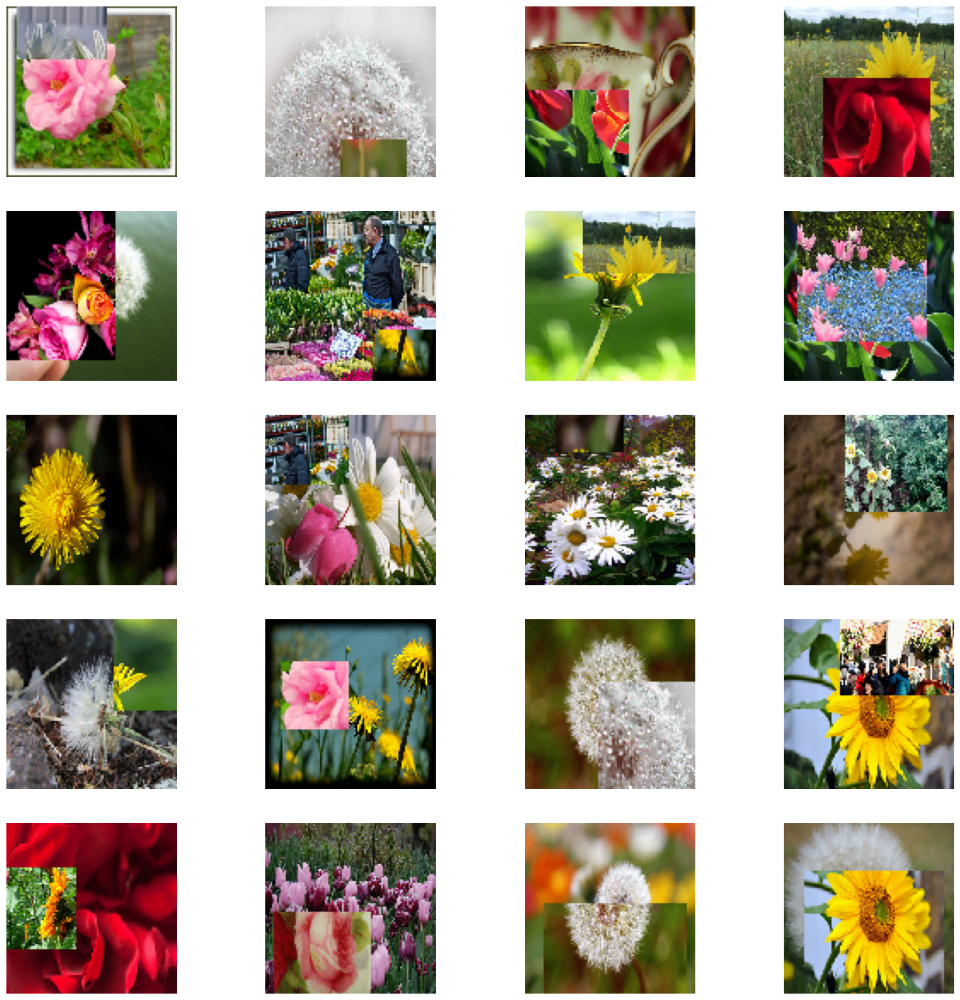

In [7]:
fig = plt.figure(figsize=(20, 20))
columns = 4
rows = 5

for i in range(1, columns*rows +1):
    img = cutmix_image[i].numpy().astype('int')
    lbl = cutmix_label[i].numpy()
    fig.add_subplot(rows, columns, i)
    plt.imshow(img)
    plt.axis("off")
plt.show()

## MixUp Augmentation

In [8]:
# keras_cv.layers.MixUp
class MixUp(keras.layers.Layer):
    """Original implementation: https://github.com/keras-team/keras-cv.
    The original implementaiton provide more interface to apply mixup on
    various CV related task, i.e. object detection etc. It also provides
    many effective validation check.

    Derived and modified for simpler usages: M.Innat.
    Ref. https://gist.github.com/innat/0ee2b6155d663aac2617fe596e1d8d49
    """

    def __init__(self, alpha=0.2, seed=None, **kwargs):
        super().__init__(**kwargs)
        self.alpha = alpha
        self.seed = seed

    @staticmethod
    def _sample_from_beta(alpha, beta, shape):
        sample_alpha = tf.random.gamma(shape, 1.0, beta=alpha)
        sample_beta = tf.random.gamma(shape, 1.0, beta=beta)
        return sample_alpha / (sample_alpha + sample_beta)

    def _mixup_samples(self, images):
        batch_size = tf.shape(images)[0]
        permutation_order = tf.random.shuffle(tf.range(0, batch_size), seed=self.seed)

        lambda_sample = MixUp._sample_from_beta(self.alpha, self.alpha, (batch_size,))
        lambda_sample = tf.reshape(lambda_sample, [-1, 1, 1, 1])

        mixup_images = tf.gather(images, permutation_order)
        images = lambda_sample * images + (1.0 - lambda_sample) * mixup_images

        return images, tf.squeeze(lambda_sample), permutation_order

    def _mixup_labels(self, labels, lambda_sample, permutation_order):
        labels_for_mixup = tf.gather(labels, permutation_order)

        lambda_sample = tf.reshape(lambda_sample, [-1, 1])
        labels = lambda_sample * labels + (1.0 - lambda_sample) * labels_for_mixup

        return labels

    def call(self, batch_inputs):
        bs_images = tf.cast(batch_inputs[0], dtype=tf.float32)  
        bs_labels = tf.cast(batch_inputs[1], dtype=tf.float32)  

        mixup_images, lambda_sample, permutation_order = self._mixup_samples(bs_images)
        mixup_labels = self._mixup_labels(bs_labels, lambda_sample, permutation_order)

        return [mixup_images, mixup_labels]

    def get_config(self):
        config = super().get_config()
        config.update(
            {
                "alpha": self.alpha,
                "seed": self.seed,
            }
        )
        return config

In [12]:
with tf.device('/device:GPU:0'):
    mixup_image, mixup_label = MixUp()(
        [images, labels]
    )

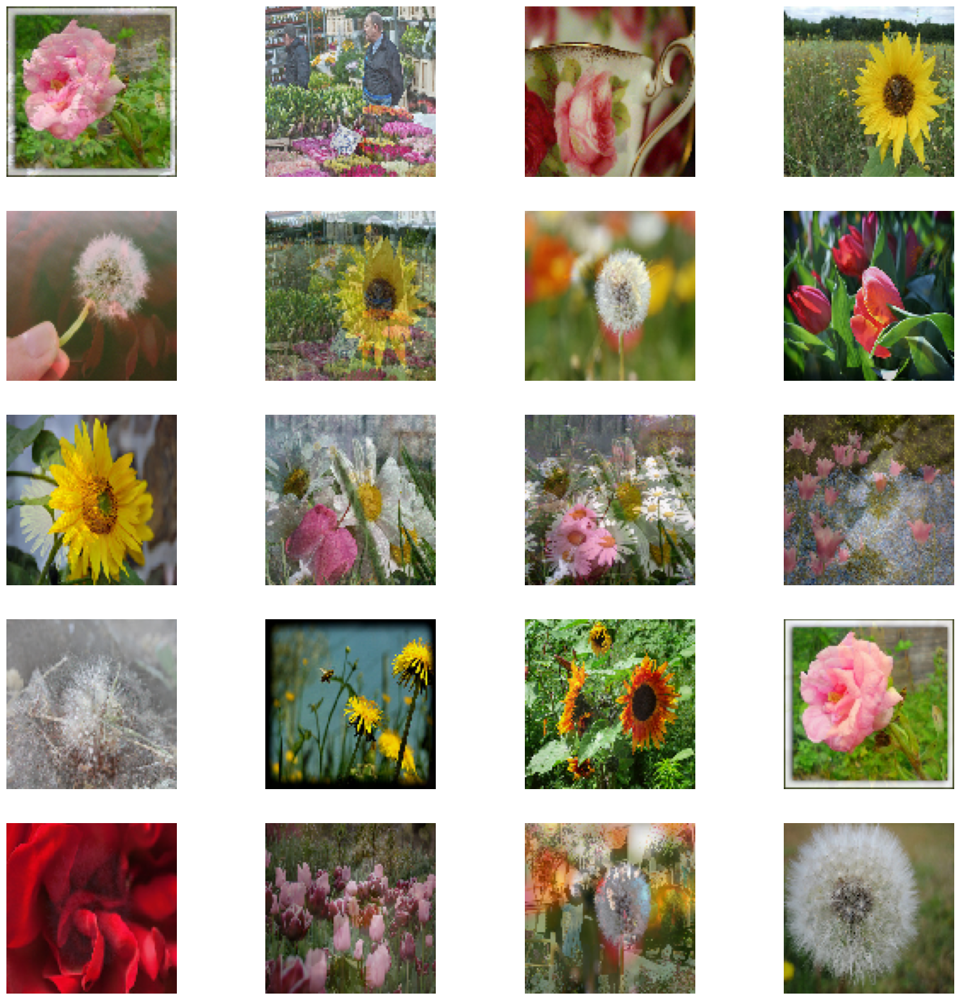

In [13]:
fig = plt.figure(figsize=(20, 20))
columns = 4
rows = 5

for i in range(1, columns*rows +1):
    img = mixup_image[i].numpy().astype('int')
    lbl = mixup_label[i].numpy()
    fig.add_subplot(rows, columns, i)
    plt.imshow(img)
    plt.axis("off")
    
plt.show()

## Channel Shuffle

In [14]:
# keras_cv.layers.ChannelShuffle
class ChannelShuffle(keras.layers.Layer):
    def __init__(self, groups=3, seed=None, **kwargs):
        super().__init__(**kwargs)
        self.groups = groups
        self.seed = seed

    def _channel_shuffling(self, images):
        height = tf.shape(images)[1]
        width = tf.shape(images)[2]
        num_channels = images.shape[3]
        channels_per_group = num_channels // self.groups
        
        images = tf.reshape(
            images, [-1, height, width, self.groups, channels_per_group]
        )
        images = tf.transpose(images, perm=[3, 1, 2, 4, 0])
        images = tf.random.shuffle(images, seed=self.seed)
        images = tf.transpose(images, perm=[4, 1, 2, 3, 0])
        images = tf.reshape(images, [-1, height, width, num_channels])
        return images

    def call(self, images, training=True):
        if training:
            return self._channel_shuffling(images)
        else:
            return images

    def get_config(self):
        config = super().get_config()
        config.update({"groups": self.groups, "seed": self.seed})
        return config

In [15]:
chlshl_image = ChannelShuffle(groups=3)(images)

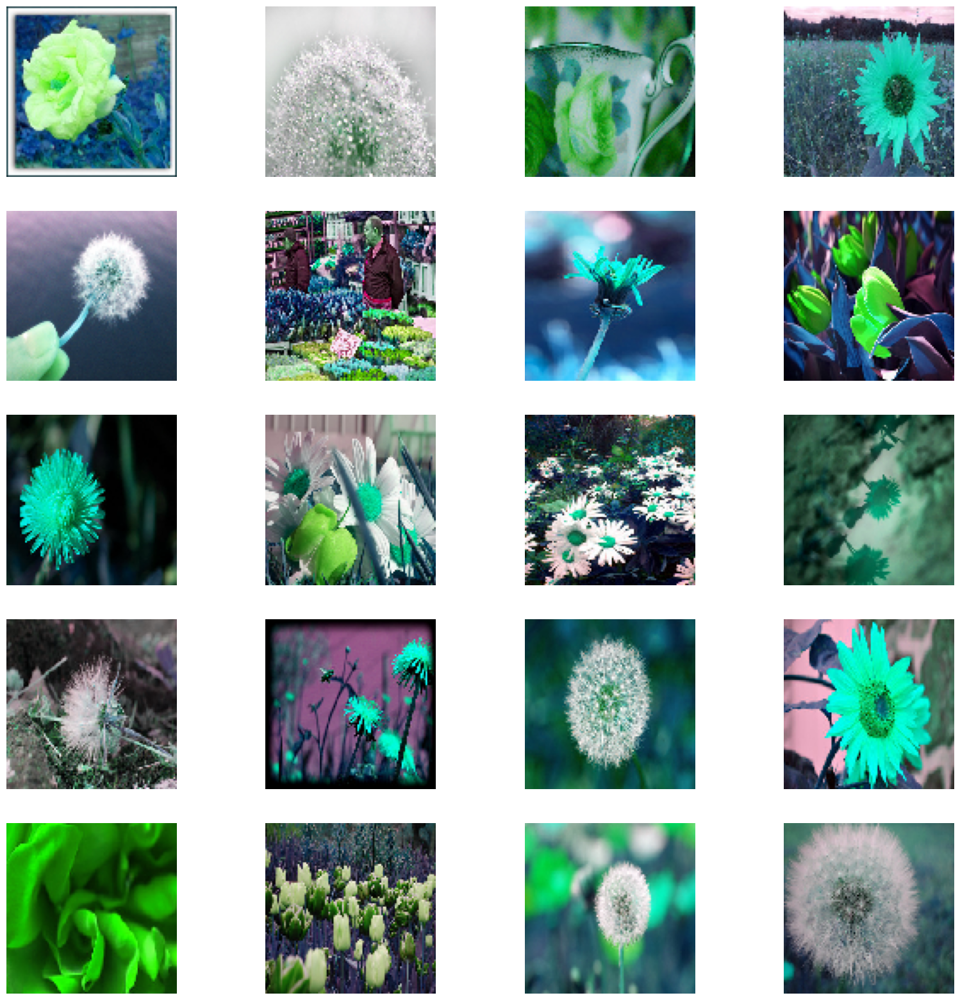

In [16]:
fig = plt.figure(figsize=(20, 20))
columns = 4
rows = 5

for i in range(1, columns*rows +1):
    img = chlshl_image[i].numpy().astype('int')
    fig.add_subplot(rows, columns, i)
    plt.imshow(img)
    plt.axis("off")
plt.show()

## Color Jitter Augmentation

In [17]:
# keras_cv.layers.RandomColorJitter
class ColorJitter(keras.layers.Layer):
    def __init__(
        self,
        brightness_factor=0.5,
        contrast_factor=(0.5, 0.9),
        saturation_factor=(0.5, 0.9),
        hue_factor=0.5,
        seed=None,
        **kwargs,
    ):
        super().__init__(**kwargs)
        self.seed = seed
        self.brightness_factor = self._check_factor_limit(
            brightness_factor, name="brightness"
        )
        self.contrast_factor = self._check_factor_limit(
            contrast_factor, name="contrast"
        )
        self.saturation_factor = self._check_factor_limit(
            saturation_factor, name="saturation"
        )
        self.hue_factor = self._check_factor_limit(hue_factor, name="hue")

    def _check_factor_limit(self, factor, name):
        if isinstance(factor, (int, float)):
            if factor < 0:
                raise TypeError(
                    "The factor value should be non-negative scalar or tuple "
                    f"or list of two upper and lower bound number. Received: {factor}"
                )
            if name == "brightness" or name == "hue":
                return abs(factor)
            return (0, abs(factor))
        elif isinstance(factor, (tuple, list)) and len(factor) == 2:
            if name == "brightness" or name == "hue":
                raise ValueError(
                    "The factor limit for brightness and hue, it should be a single "
                    f"non-negative scaler. Received: {factor} for {name}"
                )
            return sorted(factor)
        else:
            raise TypeError(
                "The factor value should be non-negative scalar or tuple "
                f"or list of two upper and lower bound number. Received: {factor}"
            )

    def _color_jitter(self, images):
        original_dtype = images.dtype
        images = tf.cast(images, dtype=tf.float32)

        brightness = tf.image.random_brightness(
            images, max_delta=self.brightness_factor * 255.0, seed=self.seed
        )
        brightness = tf.clip_by_value(brightness, 0.0, 255.0)

        contrast = tf.image.random_contrast(
            brightness,
            lower=self.contrast_factor[0],
            upper=self.contrast_factor[1],
            seed=self.seed,
        )
        saturation = tf.image.random_saturation(
            contrast,
            lower=self.saturation_factor[0],
            upper=self.saturation_factor[1],
            seed=self.seed,
        )
        hue = tf.image.random_hue(saturation, max_delta=self.hue_factor, seed=self.seed)
        return tf.cast(hue, original_dtype)

    def call(self, images, training=True):
        if training:
            return self._color_jitter(images)
        else:
            return images

    def get_config(self):
        config = super().get_config()
        config.update(
            {
                "brightness_factor": self.brightness_factor,
                "contrast_factor": self.contrast_factor,
                "saturation_factor": self.saturation_factor,
                "hue_factor": self.hue_factor,
                "seed": self.seed,
            }
        )
        return config

In [18]:
cjit_image = ColorJitter()(images)

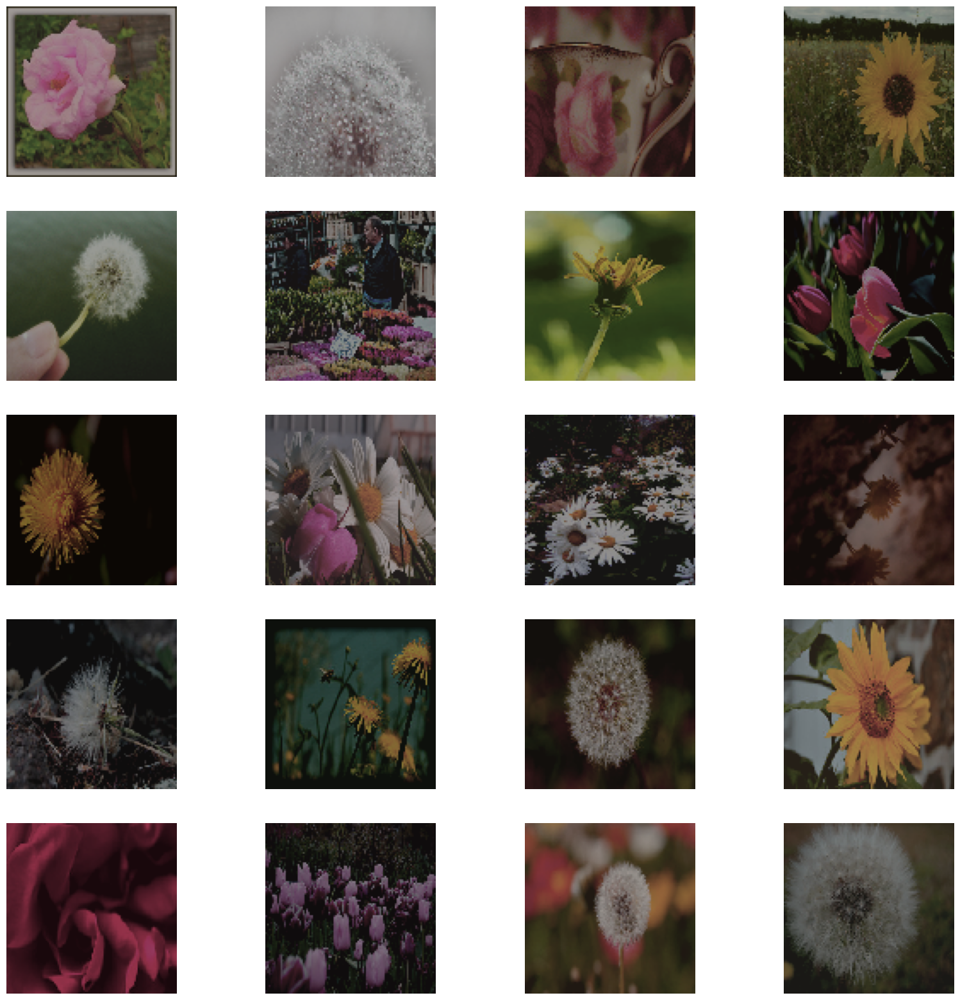

In [19]:
fig = plt.figure(figsize=(20, 20))
columns = 4
rows = 5

for i in range(1, columns*rows +1):
    img = cjit_image[i].numpy().astype('int')
    fig.add_subplot(rows, columns, i)
    plt.imshow(img)
    plt.axis("off")
plt.show()

## RGBShift

In [21]:
# keras_cv.layers.RandomChannelShift
class RGBShift(keras.layers.Layer):
    """RGBShift class randomly shift values for each channel of the input RGB image. 
    """
    def __init__(
        self,
        factor,
        seed=None,
        **kwargs
    ):
        super().__init__(**kwargs)
        self.factor = self._set_shift_limit(factor)
        self.seed = seed
        
    def _set_shift_limit(self, factor):
        if isinstance(factor, (tuple, list)):
            if len(factor) != 2: 
                raise ValueError(
                    'The factor should be scalar'
                    'tuple or list of two upper and lower' 
                    f'bound number. Got {factor}'
                )
            return self._check_factor_range(sorted(factor))
        elif isinstance(factor, (int, float)):
            factor = abs(factor)
            return self._check_factor_range([-factor, factor])
        else:
            raise ValueError(
                'The factor should be scalar'
                f'tuple or list of two upper and lower bound umber. Got {factor}'
            )
            
    @staticmethod
    def _check_factor_range(factor):
        if all(isinstance(each_elem, float) for each_elem in factor):
            if factor[0] < -1.0 or factor[1] > 1.0:
                raise ValueError(f"Got {factor}")
            return factor
        elif all(isinstance(each_elem, int) for each_elem in factor):
            if factor[0] < -255 or factor[1] > 255:
                raise ValueError(f"Got {factor}")
            return factor
        else:
            raise ValueError(f'Both bound must be same dtype. Got {factor}')
            
    def _get_random_uniform(self, shift_limit, rgb_delta_shape):
            if self.seed is not None:
                _rand_uniform = tf.random.stateless_uniform(
                    shape=rgb_delta_shape,
                    seed=[0, self.seed],
                    minval=shift_limit[0],
                    maxval=shift_limit[1],
                )
            else:
                _rand_uniform = tf.random.uniform(
                    rgb_delta_shape, 
                    minval=shift_limit[0], 
                    maxval=shift_limit[1], 
                    dtype=tf.float32
                )
                
            if all(isinstance(each_elem, float) for each_elem in shift_limit):
                _rand_uniform = _rand_uniform * 85.0
            
            return _rand_uniform
    
    def _rgb_shifting(self, images):
        rank = images.shape.rank
        original_dtype = images.dtype

        if rank == 3:
            rgb_delta_shape = (1, 1)
        elif rank == 4:
            # Keep only the batch dim. This will ensure to have same adjustment
            # with in one image, but different across the images.
            rgb_delta_shape = [tf.shape(images)[0], 1, 1]
        else:
            raise ValueError(
                f"Expect the input image to be rank 3 or 4. Got {images.shape}"
            )
        r_shift = self._get_random_uniform(self.factor, rgb_delta_shape)   
        g_shift = self._get_random_uniform(self.factor, rgb_delta_shape)
        b_shift = self._get_random_uniform(self.factor, rgb_delta_shape)
        unstack_rgb = tf.unstack(tf.cast(images, dtype=tf.float32), axis=-1)
        shifted_rgb = tf.stack(
            [
                tf.add(unstack_rgb[0], r_shift),
                tf.add(unstack_rgb[1], g_shift),
                tf.add(unstack_rgb[2], b_shift)
            ], axis=-1
        )
        shifted_rgb = tf.clip_by_value(shifted_rgb, 0.0, 255.0)
        return tf.cast(shifted_rgb, dtype=original_dtype)

    def call(self, images, training=True):
        return self._rgb_shifting(images)
    
    def get_config(self):
        config = super().get_config()
        config.update(
            {
                "factor": self.factor, 
                "seed": self.seed
            }
        )
        return config 
    def compute_output_shape(self, input_shape):
        return input_shape

In [22]:
rgbshift_images = RGBShift(factor=(-120, 120))(images)

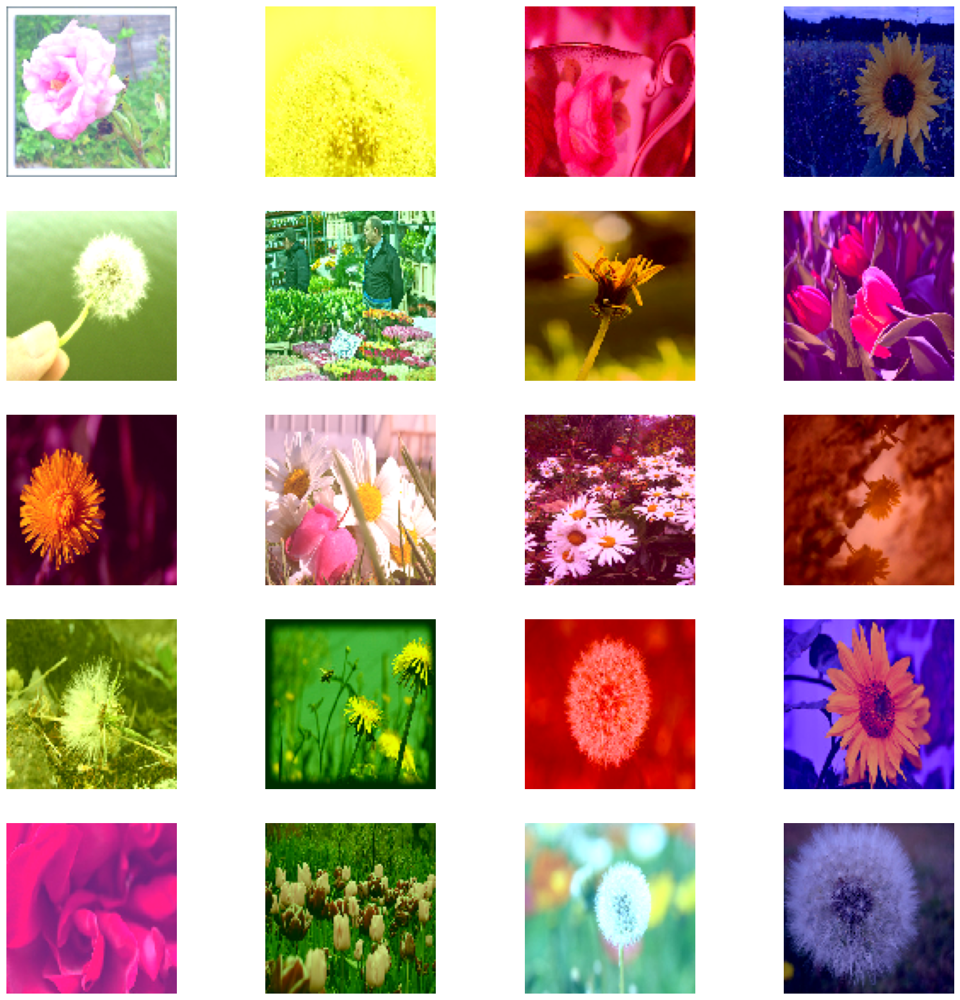

In [23]:
fig = plt.figure(figsize=(20, 20))
columns = 4
rows = 5

for i in range(1, columns*rows +1):
    img = rgbshift_images[i].numpy().astype('int')
    fig.add_subplot(rows, columns, i)
    plt.imshow(img)
    plt.axis("off")
plt.show()

# From Keras API

In [24]:
from tensorflow.keras.layers import Rescaling
from tensorflow.keras.layers import Resizing
from tensorflow.keras.layers import RandomCrop
from tensorflow.keras.layers import RandomFlip
from tensorflow.keras.layers import RandomZoom
from tensorflow.keras.layers import RandomRotation

In [25]:
keras_augmenter = keras.Sequential([
    Resizing(
        *[IMAGE_DIM[0] + 32] * 2,
        interpolation="bilinear"
    ),
    RandomCrop(
        *[IMAGE_DIM[0]] * 2
    ),
    RandomFlip("horizontal"),
    RandomZoom(0.6, fill_mode='reflect'),
    RandomRotation(0.4, fill_mode='reflect'),
])

In [26]:
keras_augmented = keras_augmenter(images, training=True)

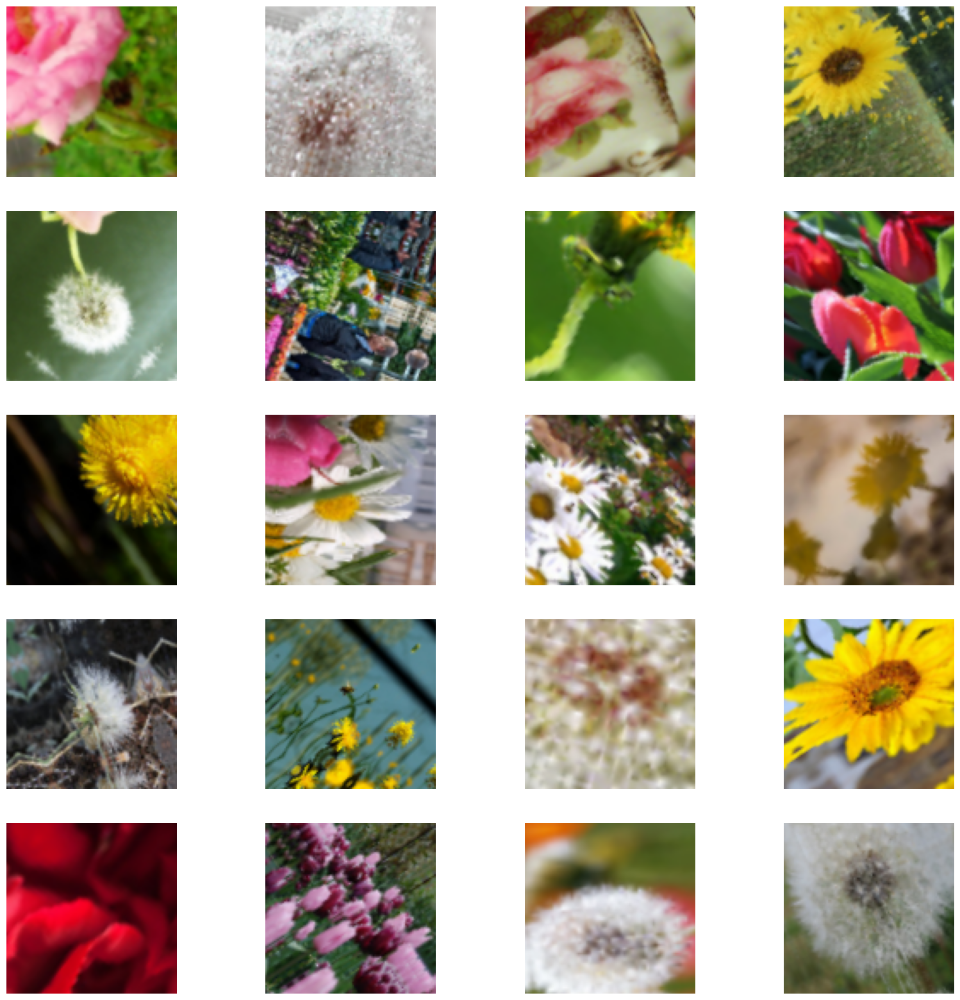

In [27]:
fig = plt.figure(figsize=(20, 20))
columns = 4
rows = 5

for i in range(1, columns*rows +1):
    img = keras_augmented[i].numpy().astype('int')
    fig.add_subplot(rows, columns, i)
    plt.imshow(img)
    plt.axis("off")
plt.show()

# All At Once

In [28]:
def plot_stuff(a, b, c, d, titles):
    plt.figure(figsize=(25, 25))
    
    plt.subplot(1, 4, 1)
    plt.axis('off')
    plt.imshow(a.astype('int'))
    plt.title(titles[0])
    
    plt.subplot(1, 4, 2)
    plt.axis('off')
    plt.imshow(b.astype('int'))
    plt.title(titles[1])
    
    plt.subplot(1, 4, 3)
    plt.axis('off')
    plt.imshow(c.astype('int'))
    plt.title(titles[2])
    
    plt.subplot(1, 4, 4)
    plt.axis('off')
    plt.imshow(d.astype('int'))
    plt.title(titles[3])
    plt.show()

In [29]:
rgbshift_images = RGBShift(factor=(-120, 120))(images)
cjit_image = ColorJitter()(images)
chlshl_image = ChannelShuffle(groups=3)(images)
kes_image = keras_augmenter(images, training=True)

mixup_image, mixup_label = MixUp()([images, labels])
cutmix_image, cutmix_label = CutMix()([images, labels])

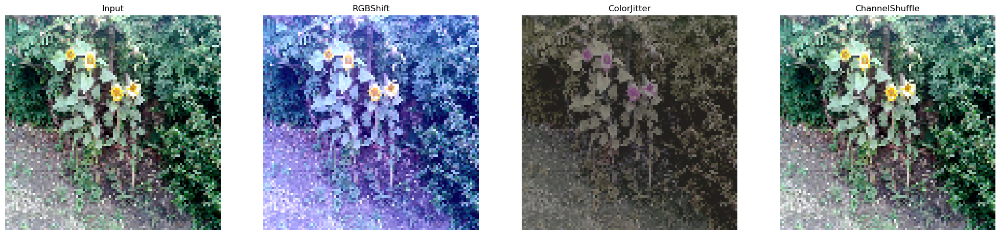

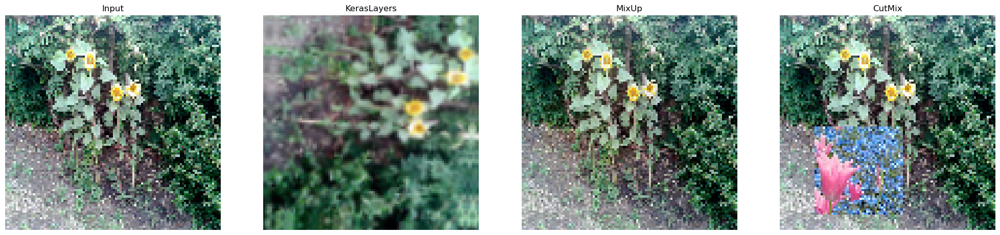

[INFO]: Iter ...............


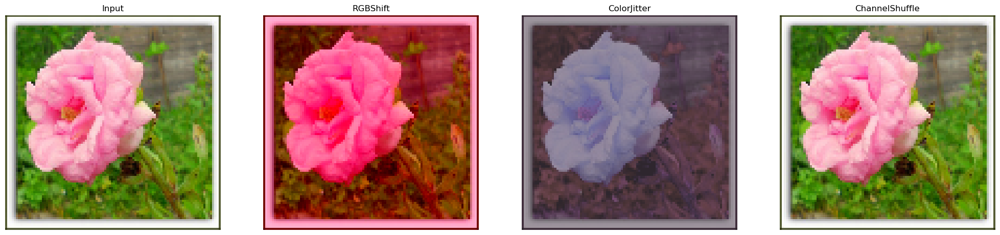

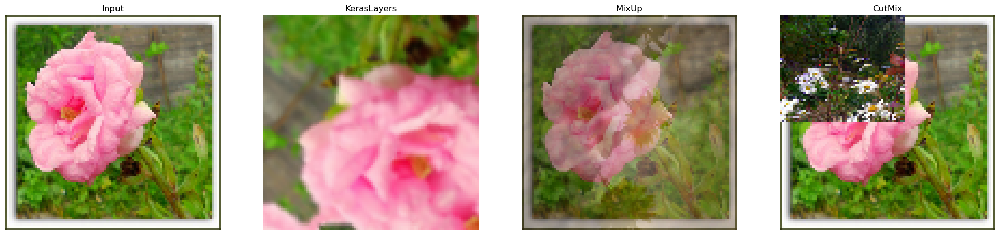

[INFO]: Iter ...............


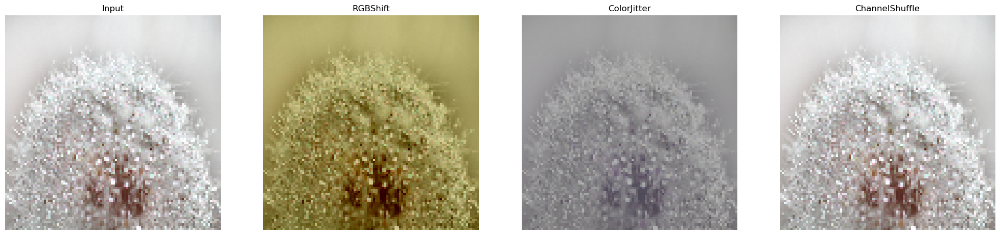

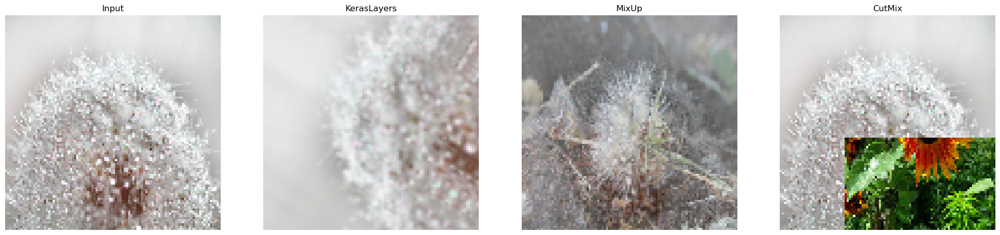

[INFO]: Iter ...............


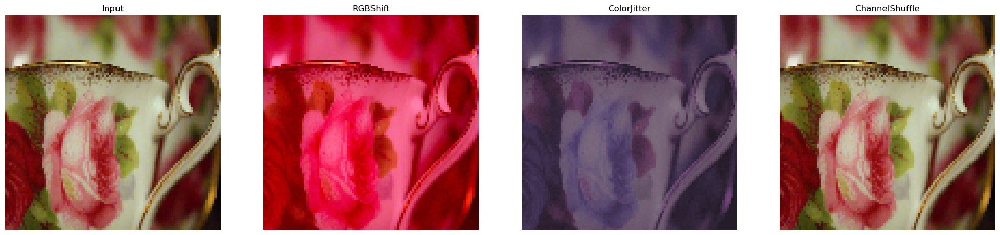

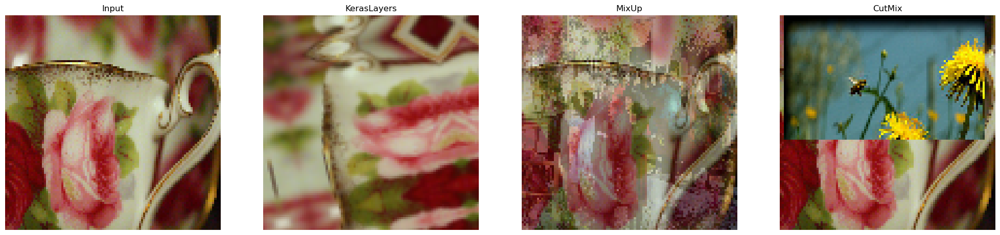

[INFO]: Iter ...............


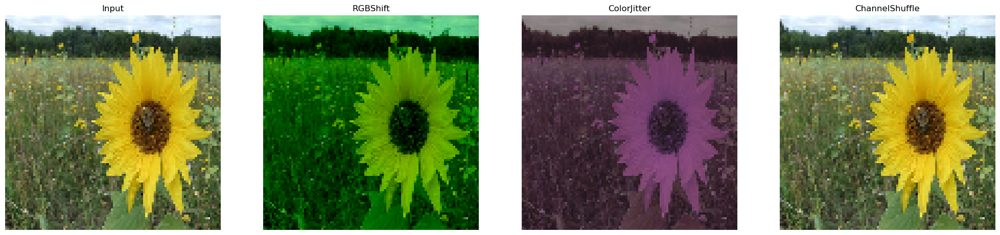

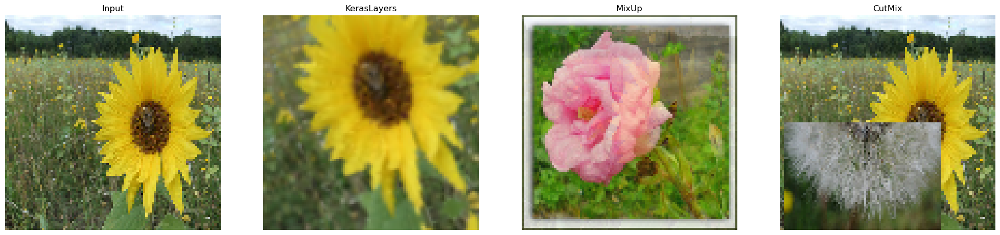

[INFO]: Iter ...............


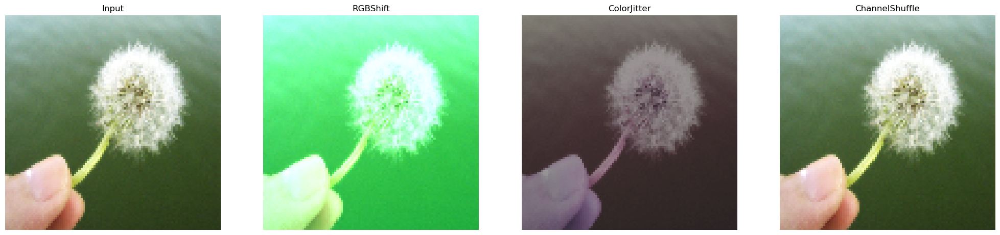

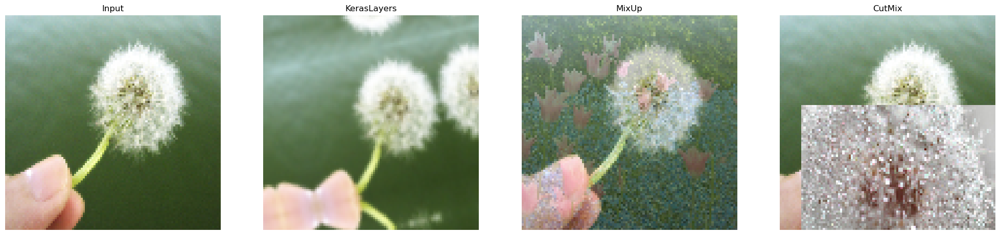

[INFO]: Iter ...............


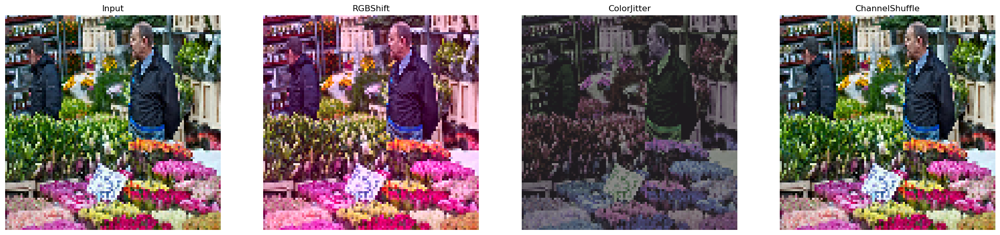

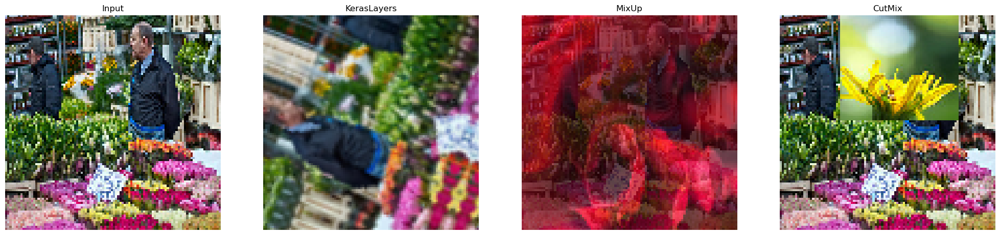

[INFO]: Iter ...............


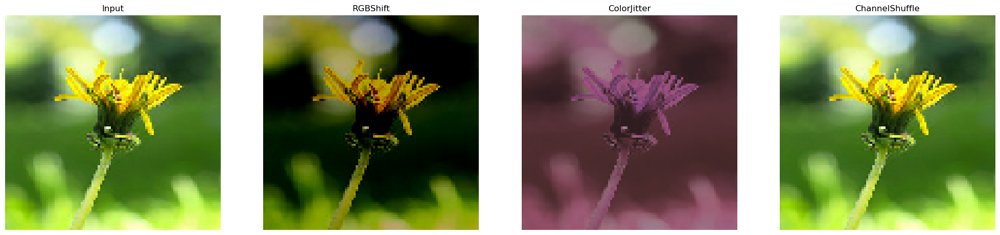

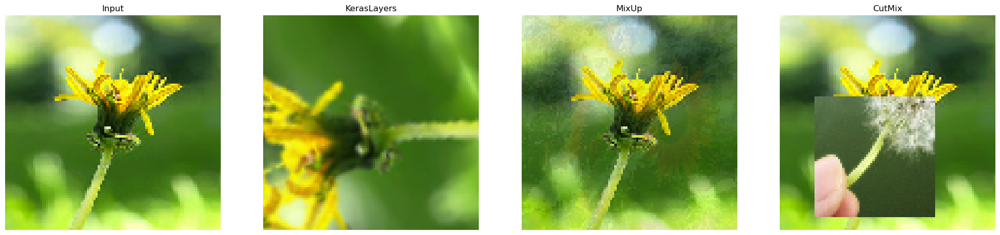

[INFO]: Iter ...............


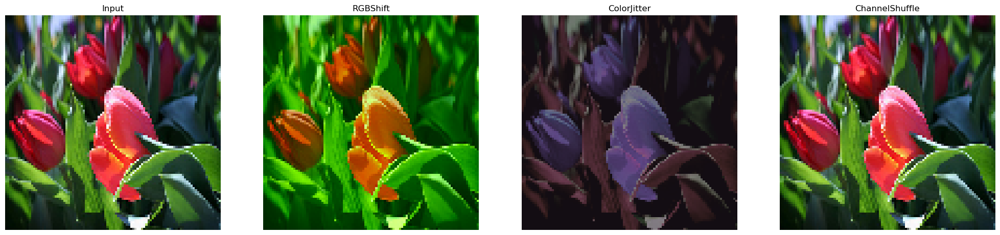

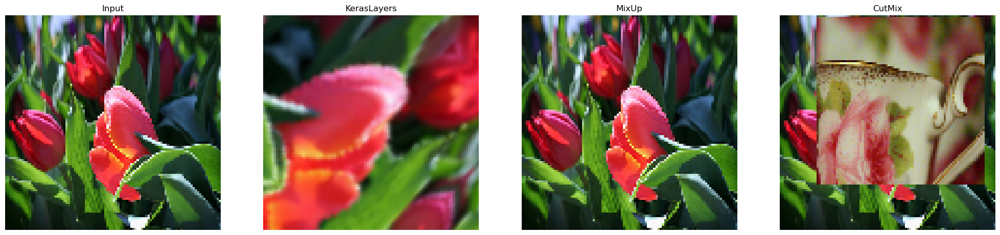

[INFO]: Iter ...............


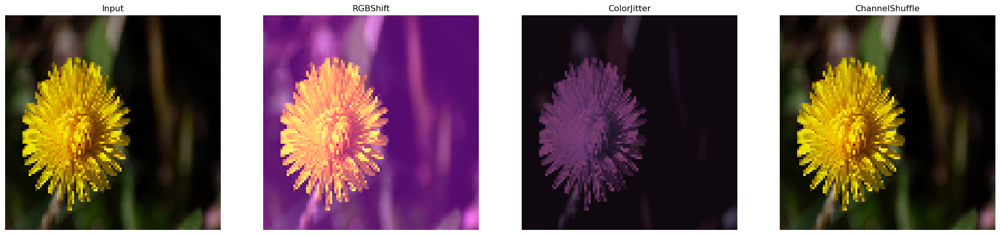

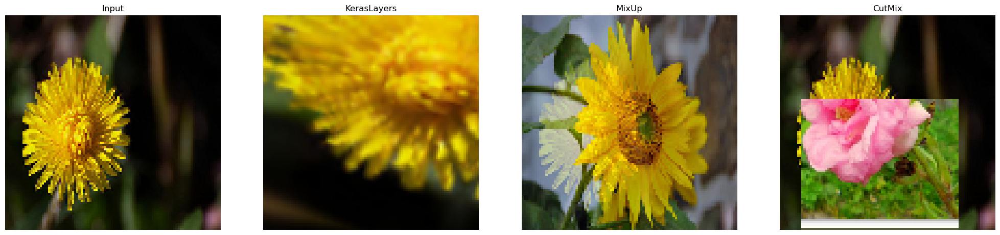

[INFO]: Iter ...............


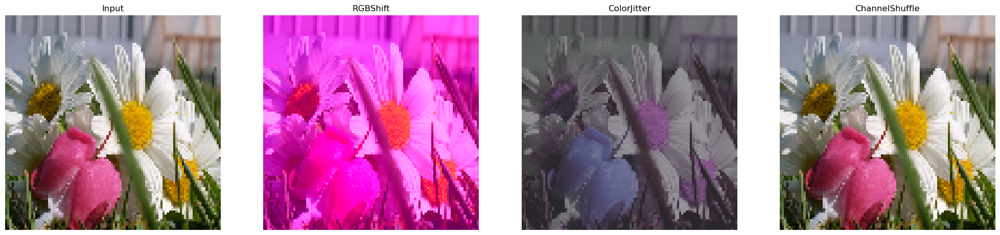

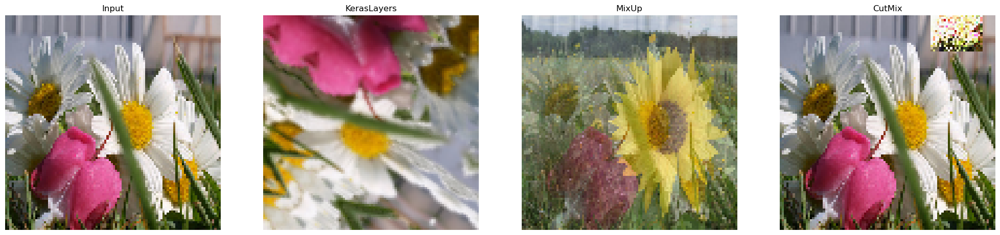

[INFO]: Iter ...............


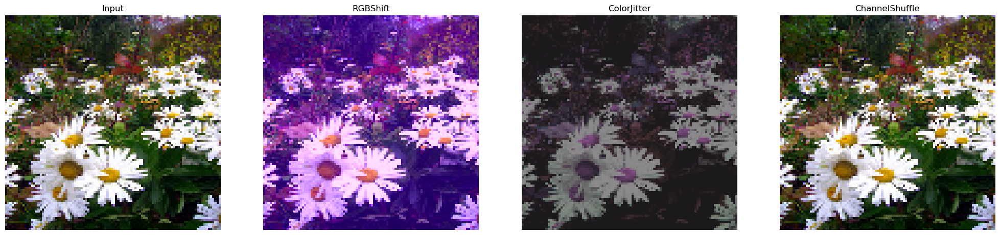

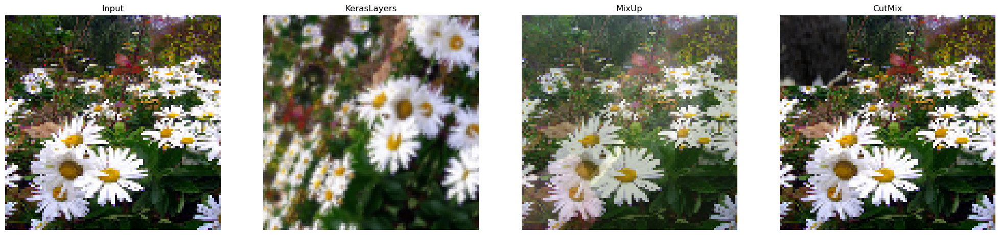

[INFO]: Iter ...............


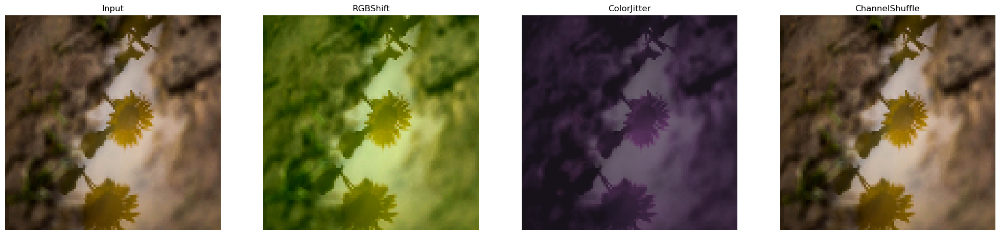

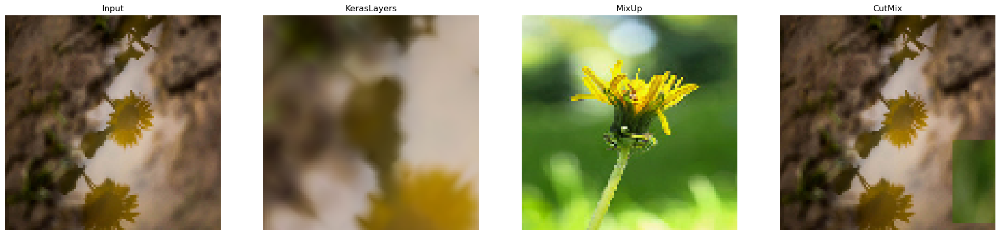

[INFO]: Iter ...............


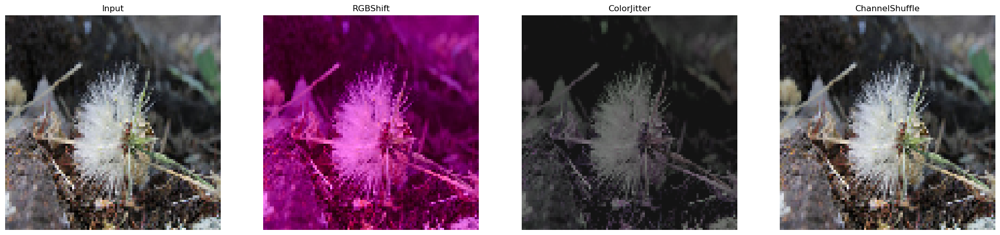

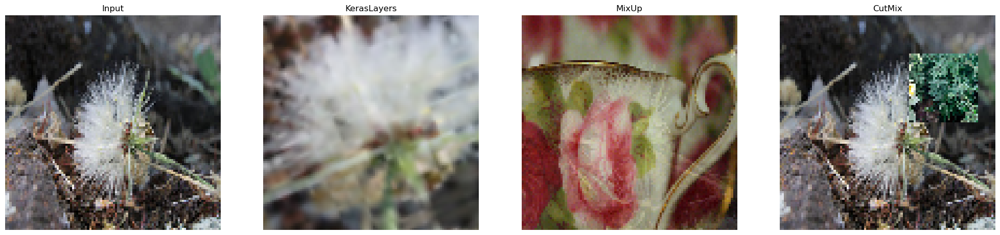

[INFO]: Iter ...............


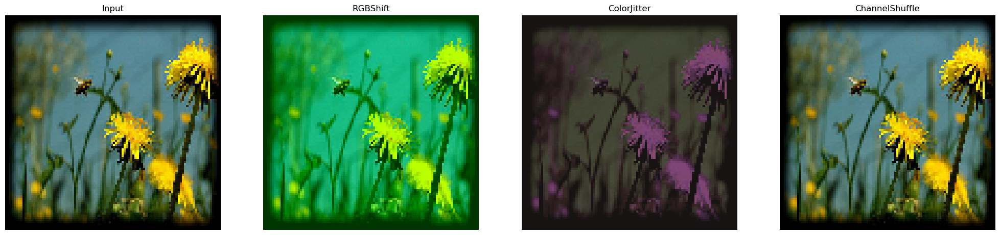

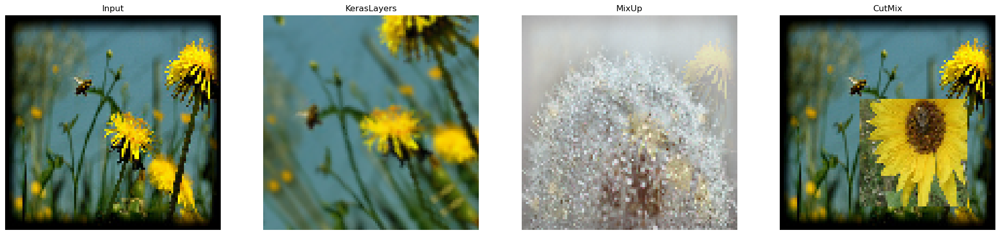

[INFO]: Iter ...............


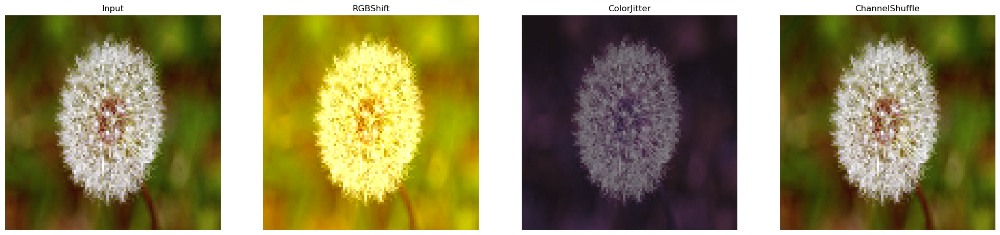

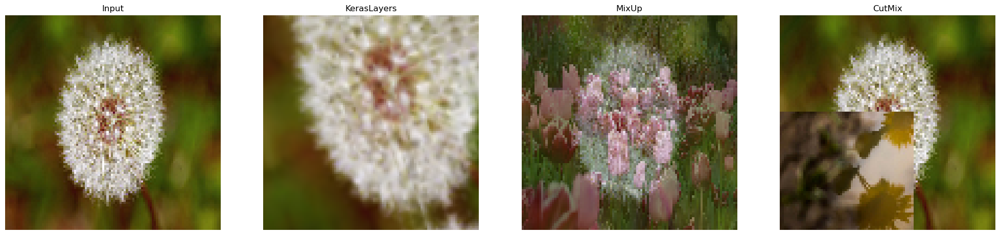

[INFO]: Iter ...............


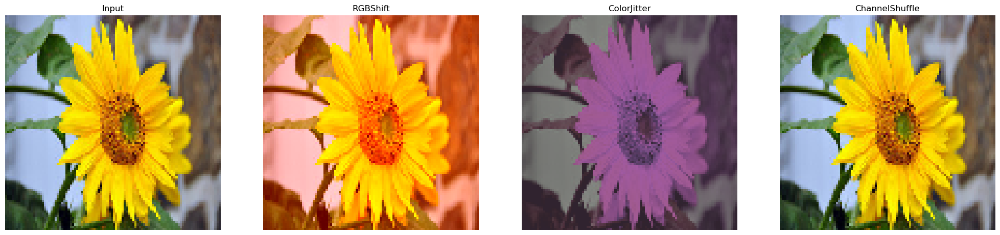

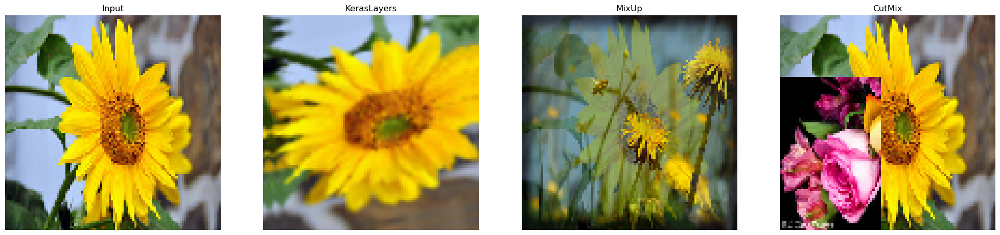

[INFO]: Iter ...............


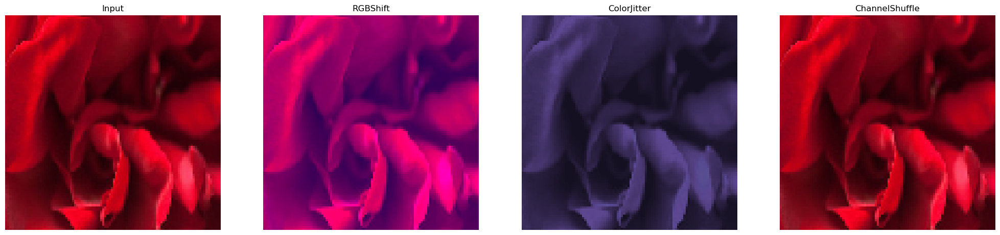

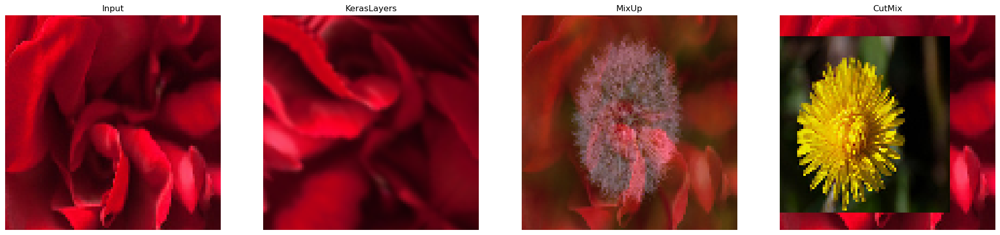

[INFO]: Iter ...............


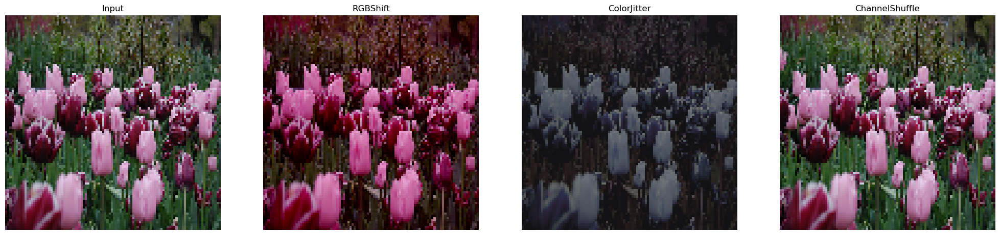

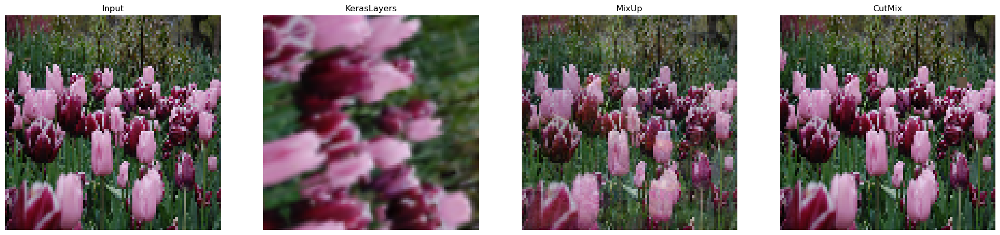

[INFO]: Iter ...............


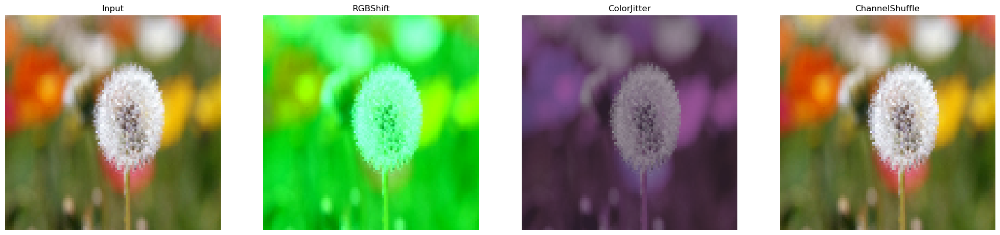

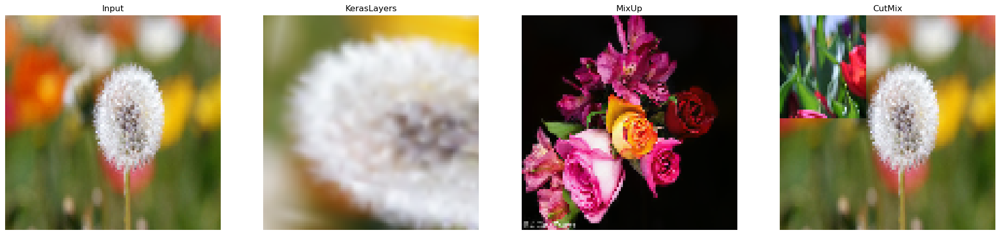

[INFO]: Iter ...............


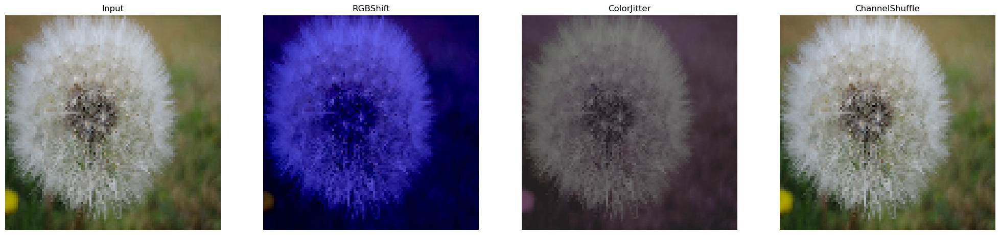

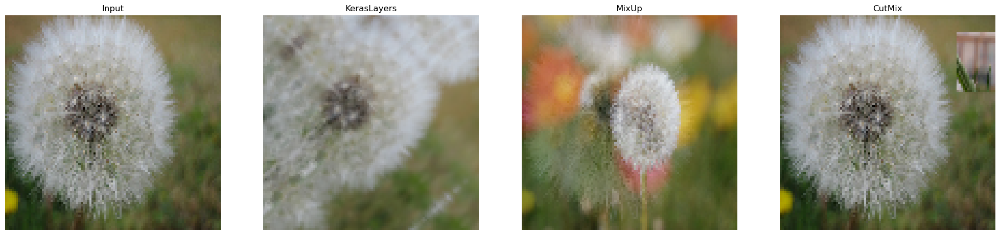

[INFO]: Iter ...............


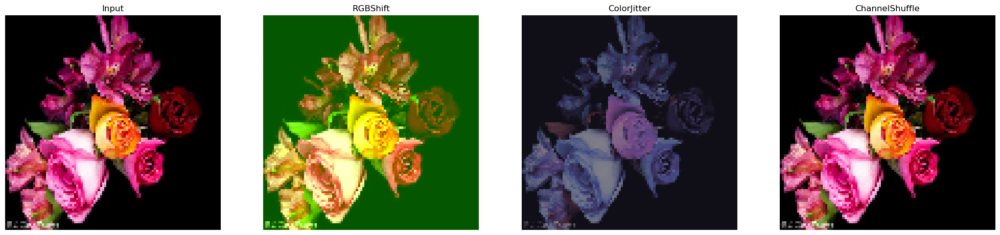

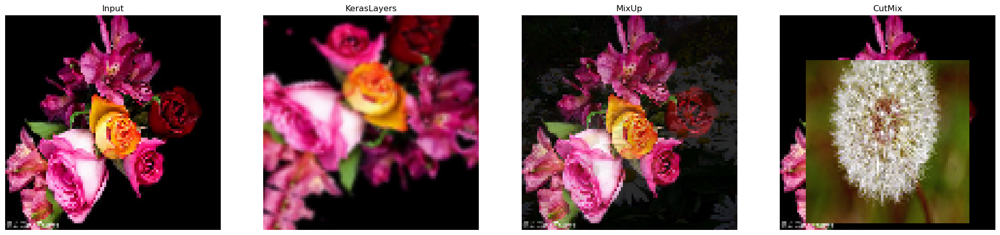

[INFO]: Iter ...............


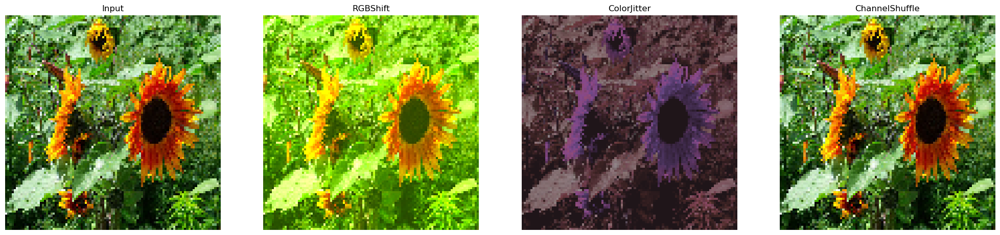

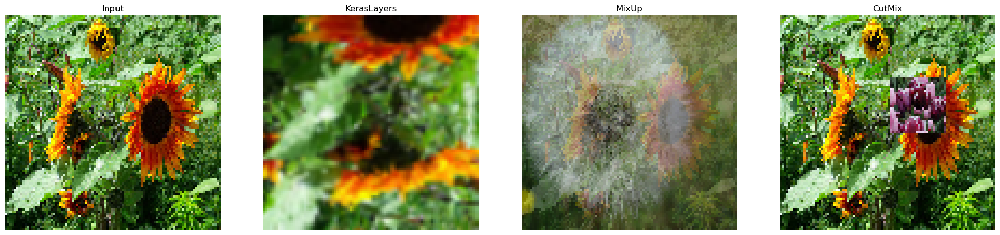

[INFO]: Iter ...............


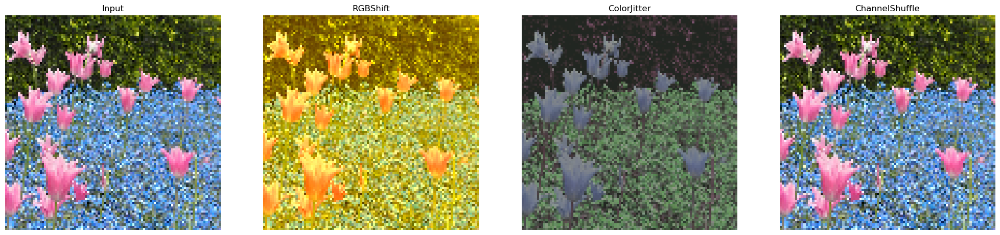

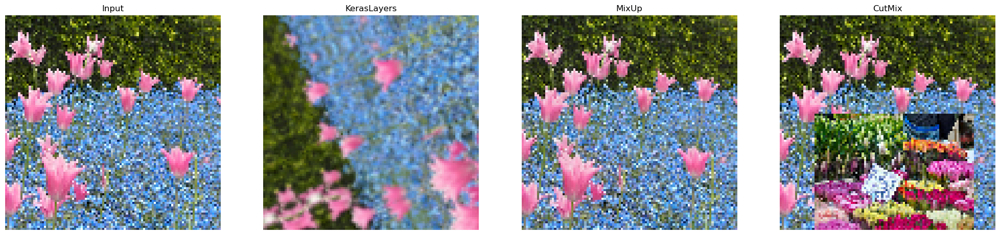

[INFO]: Iter ...............


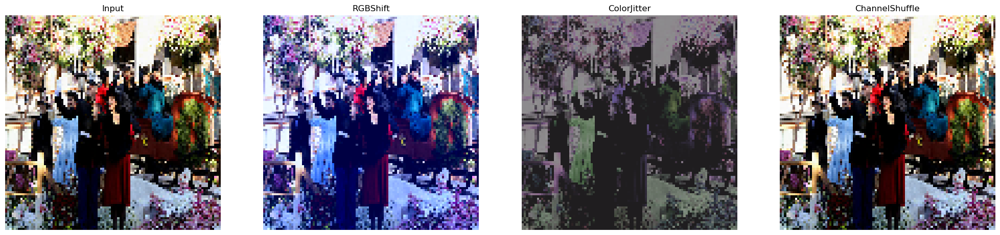

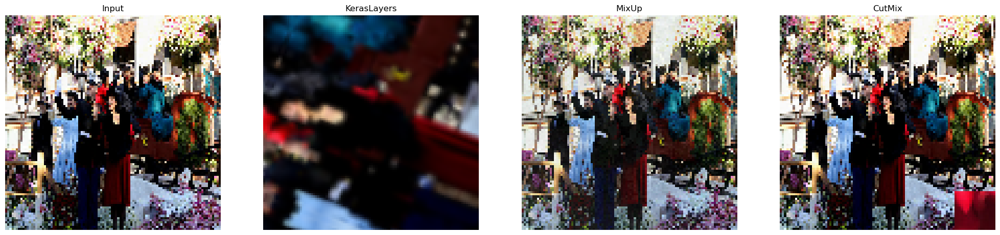

[INFO]: Iter ...............


In [30]:
for i, (orig, rg, cj, ch, fm, mi, cu) in enumerate(
    zip(
        images, rgbshift_images, cjit_image, 
        chlshl_image, kes_image, mixup_image,cutmix_image
    )
):
    plot_stuff(
        orig,
        rg.numpy(),
        cj.numpy(), 
        ch.numpy(), 
        ['Input', 'RGBShift', 'ColorJitter', 'ChannelShuffle']
    )
    
    plot_stuff(
        orig,
        fm.numpy(),
        mi.numpy(),
        cu.numpy(),
        ['Input','KerasLayers', 'MixUp', 'CutMix']
    )
    
    print('[INFO]: Iter ...............')

---

## Resource

This notebook was initially started with the following projects.

- [[TF.Keras]: Cassava: Advanced Training Mechanism](https://www.kaggle.com/ipythonx/tf-keras-cassava-advanced-training-mechanism)
- https://www.tensorflow.org/tutorials/images/data_augmentation